<a href="https://colab.research.google.com/github/MeikoFudo/Brain-Tumor-Segmentation/blob/develop/Sentiment_analysis_with_hotel_reviews.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = '515k-hotel-reviews-data-in-europe:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F2142%2F3597%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240820%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240820T140618Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D9d1732b48e0fed98b2442d74b844da46670caf64d7f8d669708a2a414cbd1f2be4cc19a0fc8d1fe90e7bd0e12a66a5be22b482c302ad1ce94c69551db0d75aa909e7ca6a85d90013ac9c2c3616f6417ca7d3bd6e95701bfe4418634cee30f662d5a07dc904fcafa1a7061f76c7de41adb265e9b73510eca5df22661a106ff49f50d9758acc50e613fcb7be08745f5555cf3ce14bab7fe0f7f088807fb731b575a40336f6800608a72436034958cebd512c76bd8de6d39ff6fc7ce3058a5528d9ab3df1a68b4acccd56c5230cff334e9e5c752ad0c2a445622bc19950f481fa489e2e07f047991537d7946b185532213858ea66af6a36acbfc081fe3053deb091'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


In [ ]:
import pandas as pd
from collections import Counter
from wordcloud import WordCloud, STOPWORDS
import seaborn as sns
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import string

import tensorflow as tf
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.decomposition import TruncatedSVD
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, ConfusionMatrixDisplay, roc_curve, auc, roc_auc_score
from plotly.offline import iplot
import plotly.graph_objects as go
import xgboost as xgb

sns.set_style("darkgrid")

In [ ]:
gpus = tf.config.list_physical_devices('GPU')

if gpus:
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
        tf.config.set_visible_devices(gpus[0], 'GPU')
        print(f"Количество доступных GPU: {len(gpus)}")
        for gpu in gpus:
            print(f"Имя GPU: {gpu.name}")
    except RuntimeError as e:
        print(f"Ошибка при настройке GPU: {e}")
else:
    print("GPU не обнаружен. Используется CPU.")


Количество доступных GPU: 2
Имя GPU: /physical_device:GPU:0
Имя GPU: /physical_device:GPU:1


In [ ]:
df = pd.read_csv('/kaggle/input/515k-hotel-reviews-data-in-europe/Hotel_Reviews.csv')
df

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,210,1403,Great location in nice surroundings the bar a...,26,1,3.8,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days,52.360576,4.915968
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/24/2017,7.7,Hotel Arena,New Zealand,You When I booked with your company on line y...,140,1403,Amazing location and building Romantic setting,8,3,6.7,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days,52.360576,4.915968
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
515733,Wurzbachgasse 21 15 Rudolfsheim F nfhaus 1150 ...,168,8/30/2015,8.1,Atlantis Hotel Vienna,Kuwait,no trolly or staff to help you take the lugga...,14,2823,location,2,8,7.0,"[' Leisure trip ', ' Family with older childre...",704 day,48.203745,16.335677
515734,Wurzbachgasse 21 15 Rudolfsheim F nfhaus 1150 ...,168,8/22/2015,8.1,Atlantis Hotel Vienna,Estonia,The hotel looks like 3 but surely not 4,11,2823,Breakfast was ok and we got earlier check in,11,12,5.8,"[' Leisure trip ', ' Family with young childre...",712 day,48.203745,16.335677
515735,Wurzbachgasse 21 15 Rudolfsheim F nfhaus 1150 ...,168,8/19/2015,8.1,Atlantis Hotel Vienna,Egypt,The ac was useless It was a hot week in vienn...,19,2823,No Positive,0,3,2.5,"[' Leisure trip ', ' Family with older childre...",715 day,48.203745,16.335677
515736,Wurzbachgasse 21 15 Rudolfsheim F nfhaus 1150 ...,168,8/17/2015,8.1,Atlantis Hotel Vienna,Mexico,No Negative,0,2823,The rooms are enormous and really comfortable...,25,3,8.8,"[' Leisure trip ', ' Group ', ' Standard Tripl...",717 day,48.203745,16.335677


In [ ]:
df.describe()

,Additional_Number_of_Scoring,Average_Score,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,lat,lng
count,515738.000000,515738.000000,515738.000000,515738.000000,515738.000000,515738.000000,515738.000000,512470.000000,512470.000000
mean,498.081836,8.397487,18.539450,2743.743944,17.776458,7.166001,8.395077,49.442439,2.823803
std,500.538467,0.548048,29.690831,2317.464868,21.804185,11.040228,1.637856,3.466325,4.579425
min,1.000000,5.200000,0.000000,43.000000,0.000000,1.000000,2.500000,41.328376,-0.369758
25%,169.000000,8.100000,2.000000,1161.000000,5.000000,1.000000,7.500000,48.214662,-0.143372
50%,341.000000,8.400000,9.000000,2134.000000,11.000000,3.000000,8.800000,51.499981,0.010607
75%,660.000000,8.800000,23.000000,3613.000000,22.000000,8.000000,9.600000,51.516288,4.834443
max,2682.000000,9.800000,408.000000,16670.000000,395.000000,355.000000,10.000000,52.400181,16.429233


In [ ]:
df.isna().sum()

Hotel_Address                                    0
Additional_Number_of_Scoring                     0
Review_Date                                      0
Average_Score                                    0
Hotel_Name                                       0
Reviewer_Nationality                             0
Negative_Review                                  0
Review_Total_Negative_Word_Counts                0
Total_Number_of_Reviews                          0
Positive_Review                                  0
Review_Total_Positive_Word_Counts                0
Total_Number_of_Reviews_Reviewer_Has_Given       0
Reviewer_Score                                   0
Tags                                             0
days_since_review                                0
lat                                           3268
lng                                           3268
dtype: int64

In [ ]:
df.dropna(inplace=True,axis=0)

In [ ]:
df.isna().sum()

Hotel_Address                                 0
Additional_Number_of_Scoring                  0
Review_Date                                   0
Average_Score                                 0
Hotel_Name                                    0
Reviewer_Nationality                          0
Negative_Review                               0
Review_Total_Negative_Word_Counts             0
Total_Number_of_Reviews                       0
Positive_Review                               0
Review_Total_Positive_Word_Counts             0
Total_Number_of_Reviews_Reviewer_Has_Given    0
Reviewer_Score                                0
Tags                                          0
days_since_review                             0
lat                                           0
lng                                           0
dtype: int64

In [ ]:
print("Количество дубликатов до очистки",df.duplicated().sum())
df.drop_duplicates(inplace=True)
print("Количество дубликатов после очистки",df.duplicated().sum())

Количество дубликатов до очистки 526
Количество дубликатов после очистки 0


In [ ]:
df

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,210,1403,Great location in nice surroundings the bar a...,26,1,3.8,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days,52.360576,4.915968
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/24/2017,7.7,Hotel Arena,New Zealand,You When I booked with your company on line y...,140,1403,Amazing location and building Romantic setting,8,3,6.7,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days,52.360576,4.915968
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
515733,Wurzbachgasse 21 15 Rudolfsheim F nfhaus 1150 ...,168,8/30/2015,8.1,Atlantis Hotel Vienna,Kuwait,no trolly or staff to help you take the lugga...,14,2823,location,2,8,7.0,"[' Leisure trip ', ' Family with older childre...",704 day,48.203745,16.335677
515734,Wurzbachgasse 21 15 Rudolfsheim F nfhaus 1150 ...,168,8/22/2015,8.1,Atlantis Hotel Vienna,Estonia,The hotel looks like 3 but surely not 4,11,2823,Breakfast was ok and we got earlier check in,11,12,5.8,"[' Leisure trip ', ' Family with young childre...",712 day,48.203745,16.335677
515735,Wurzbachgasse 21 15 Rudolfsheim F nfhaus 1150 ...,168,8/19/2015,8.1,Atlantis Hotel Vienna,Egypt,The ac was useless It was a hot week in vienn...,19,2823,No Positive,0,3,2.5,"[' Leisure trip ', ' Family with older childre...",715 day,48.203745,16.335677
515736,Wurzbachgasse 21 15 Rudolfsheim F nfhaus 1150 ...,168,8/17/2015,8.1,Atlantis Hotel Vienna,Mexico,No Negative,0,2823,The rooms are enormous and really comfortable...,25,3,8.8,"[' Leisure trip ', ' Group ', ' Standard Tripl...",717 day,48.203745,16.335677


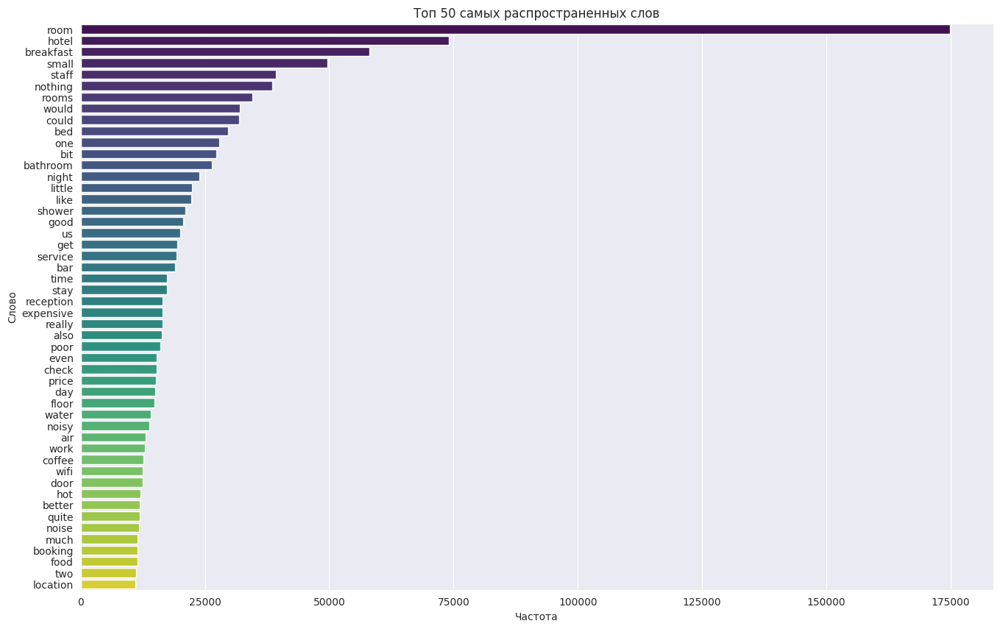

In [ ]:
def plot_word_distribution(text_column, top_n=50):
    word_counts = Counter()

    stop_words = set(stopwords.words('english'))

    for text in text_column:
        tokens = word_tokenize(text.lower())
        tokens = [word for word in tokens if word.isalpha() and word not in stop_words and word not in ['negative', 'positive']]
        word_counts.update(tokens)

    word_freq_df = pd.DataFrame(word_counts.most_common(top_n), columns=['Word', 'Frequency'])
    plt.figure(figsize=(16, 10))

    sns.barplot(x='Frequency', y='Word', data=word_freq_df, palette='viridis')
    plt.title(f'Топ {top_n} самых распространенных слов')
    plt.xlabel('Частота')
    plt.ylabel('Слово')
    plt.show()

plot_word_distribution(df['Negative_Review'])


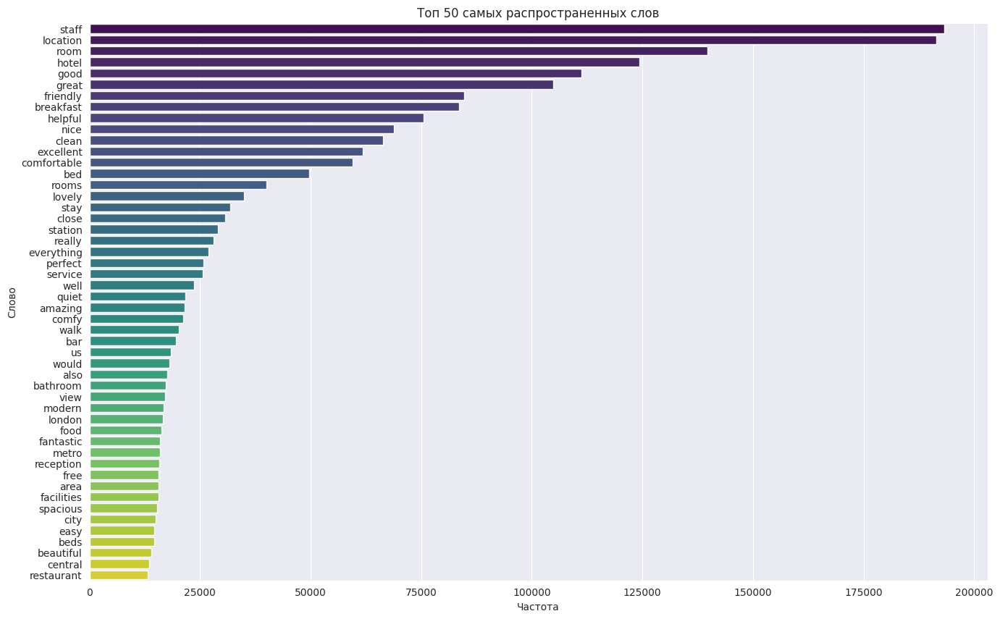

In [ ]:
plot_word_distribution(df['Positive_Review'])

In [ ]:
custom_stopwords = set(STOPWORDS)
custom_stopwords.add('negative')
custom_stopwords.add('positive')

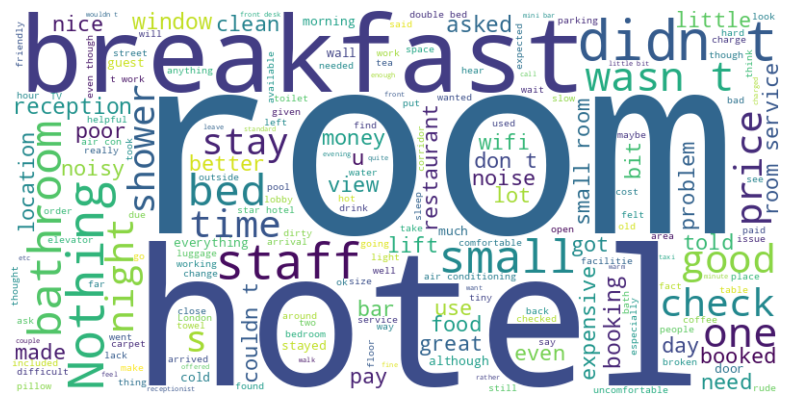

In [ ]:
text = ' '.join(df['Negative_Review'])

wordcloud_negative = WordCloud(
    width=800,
    height=400,
    background_color='white',
    stopwords=custom_stopwords
).generate(text)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud_negative, interpolation='bilinear')
plt.axis('off')
plt.show()

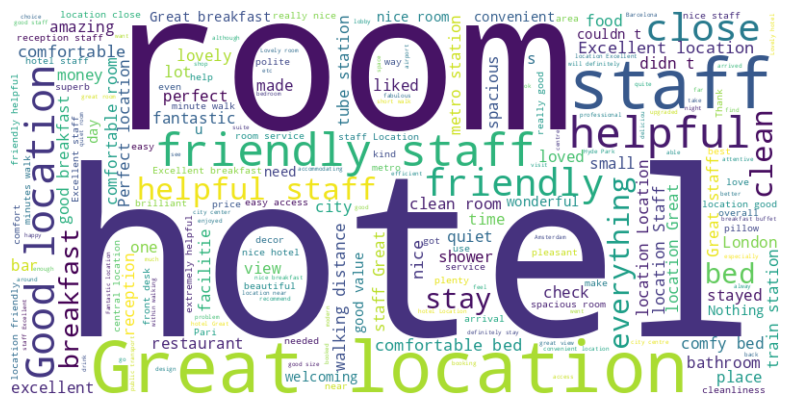

In [ ]:
text = ' '.join(df['Positive_Review'])

wordcloud_positive = WordCloud(
    width=800,
    height=400,
    background_color='white',
    stopwords=custom_stopwords
).generate(text)


plt.figure(figsize=(10, 5))
plt.imshow(wordcloud_positive, interpolation='bilinear')
plt.axis('off')
plt.show()

In [ ]:
df.Reviewer_Nationality.value_counts()[:50]

Reviewer_Nationality
United Kingdom               244321
United States of America      35108
Australia                     21502
Ireland                       14733
United Arab Emirates          10170
Saudi Arabia                   8903
Netherlands                    8691
Switzerland                    8607
Germany                        7831
Canada                         7802
France                         7202
Israel                         6527
Italy                          6060
Belgium                        5984
Turkey                         5379
Kuwait                         4899
Spain                          4692
Romania                        4420
Russia                         3842
South Africa                   3790
India                          3399
China                          3372
Greece                         3346
Sweden                         3333
New Zealand                    3218
Singapore                      3072
Hong Kong                      2993
Poland 

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



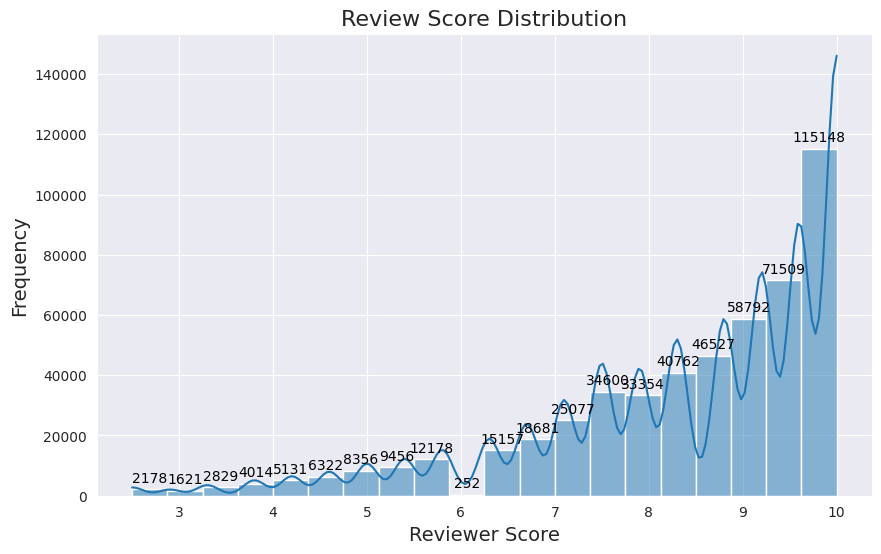

In [ ]:
plt.figure(figsize=(10, 6))
ax = sns.histplot(data=df, x="Reviewer_Score", bins=20, kde=True)

ax.set_title('Review Score Distribution', fontsize=16)
ax.set_xlabel('Reviewer Score', fontsize=14)
ax.set_ylabel('Frequency', fontsize=14)

for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 8),
                textcoords = 'offset points',
                fontsize=10, color='black')

plt.show()

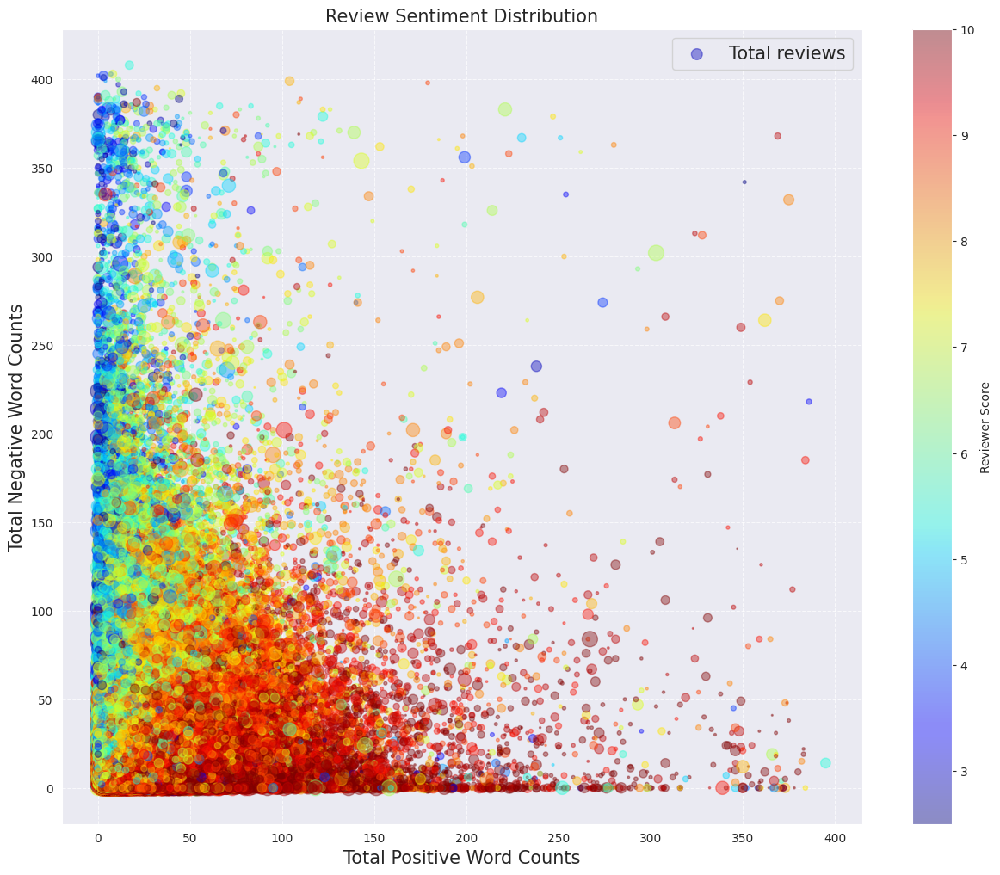

In [ ]:
plt.figure(figsize=(15, 12))

scatter = plt.scatter(
    x=df['Review_Total_Positive_Word_Counts'],
    y=df['Review_Total_Negative_Word_Counts'],
    s=df['Total_Number_of_Reviews']/100,
    c=df['Reviewer_Score'],
    cmap='jet',
    alpha=0.4
)

cbar = plt.colorbar(scatter)
cbar.set_label('Reviewer Score')

font_size = 15
plt.title("Review Sentiment Distribution", fontsize=font_size)
plt.xlabel("Total Positive Word Counts", fontsize=font_size)
plt.ylabel("Total Negative Word Counts", fontsize=font_size)

plt.legend(['Total reviews'], loc='upper right', fontsize=font_size, frameon=True)

plt.grid(True, linestyle='--', alpha=0.7)

plt.show()


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



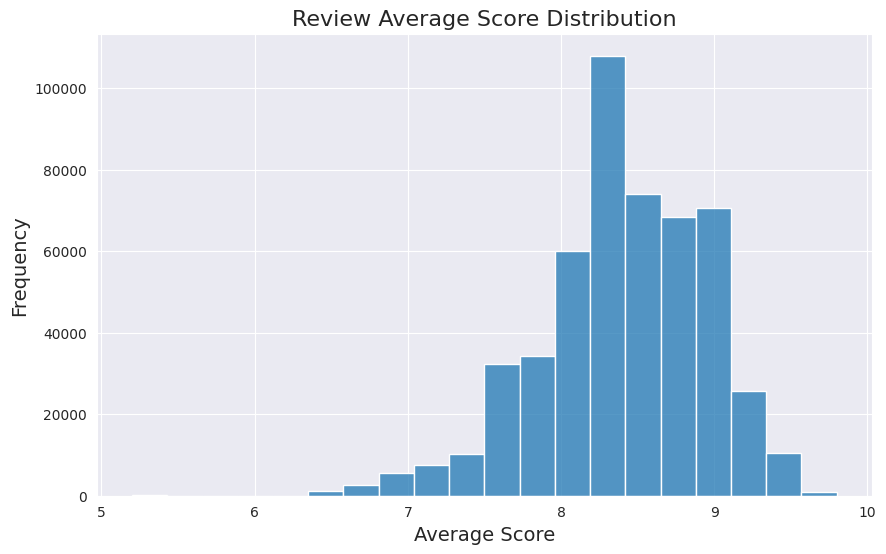

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(df, x="Average_Score", bins=20, kde=False)

plt.title('Review Average Score Distribution', fontsize=16)
plt.xlabel('Average Score', fontsize=14)
plt.ylabel('Frequency', fontsize=14)

plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



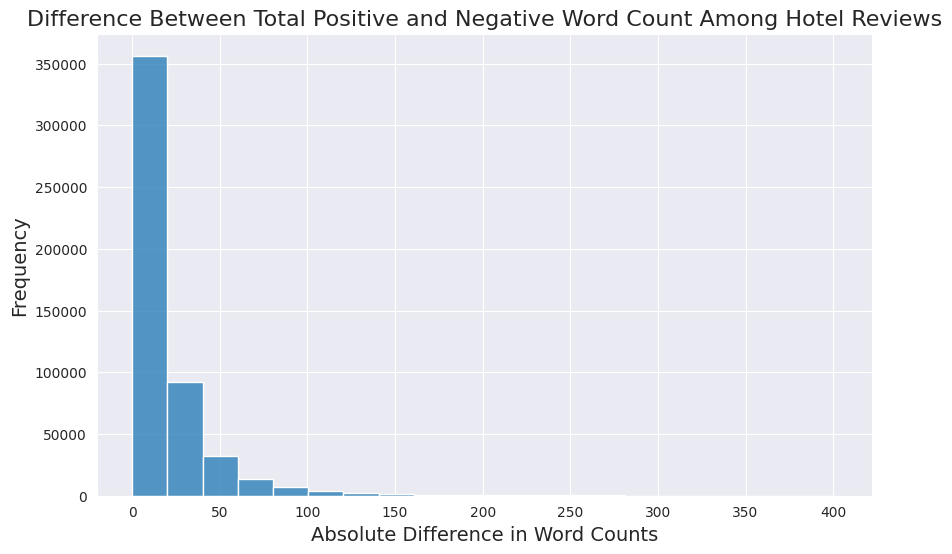

In [ ]:
difference = abs(df['Review_Total_Positive_Word_Counts'] - df['Review_Total_Negative_Word_Counts'])

plt.figure(figsize=(10, 6))
sns.histplot(difference, bins=20, kde=False)

plt.title('Difference Between Total Positive and Negative Word Count Among Hotel Reviews', fontsize=16)
plt.xlabel('Absolute Difference in Word Counts', fontsize=14)
plt.ylabel('Frequency', fontsize=14)

plt.show()

In [ ]:
hotel_trace = go.Scattermapbox(
    lat=df['lat'],
    lon=df['lng'],
    mode='markers',
    marker=dict(
        size=4,
        color='cyan',
        opacity=0.7,
    ),
    text=df['Hotel_Name'],
    hoverinfo='text',
)

layout = go.Layout(
    autosize=False,
    hovermode='closest',
    mapbox=dict(
        accesstoken="pk.eyJ1Ijoic2hhejEzIiwiYSI6ImNqYXA3NjhmeDR4d3Iyd2w5M2phM3E2djQifQ.yyxsAzT94VGYYEEOhxy87w",
        center=dict(lat=48.8566, lon=2.3522),
        zoom=12,
    ),
    width=900,
    height=600,
    title="Drop off locations of hotels"
)

fig = go.Figure(data=[hotel_trace], layout=layout)

iplot(fig)


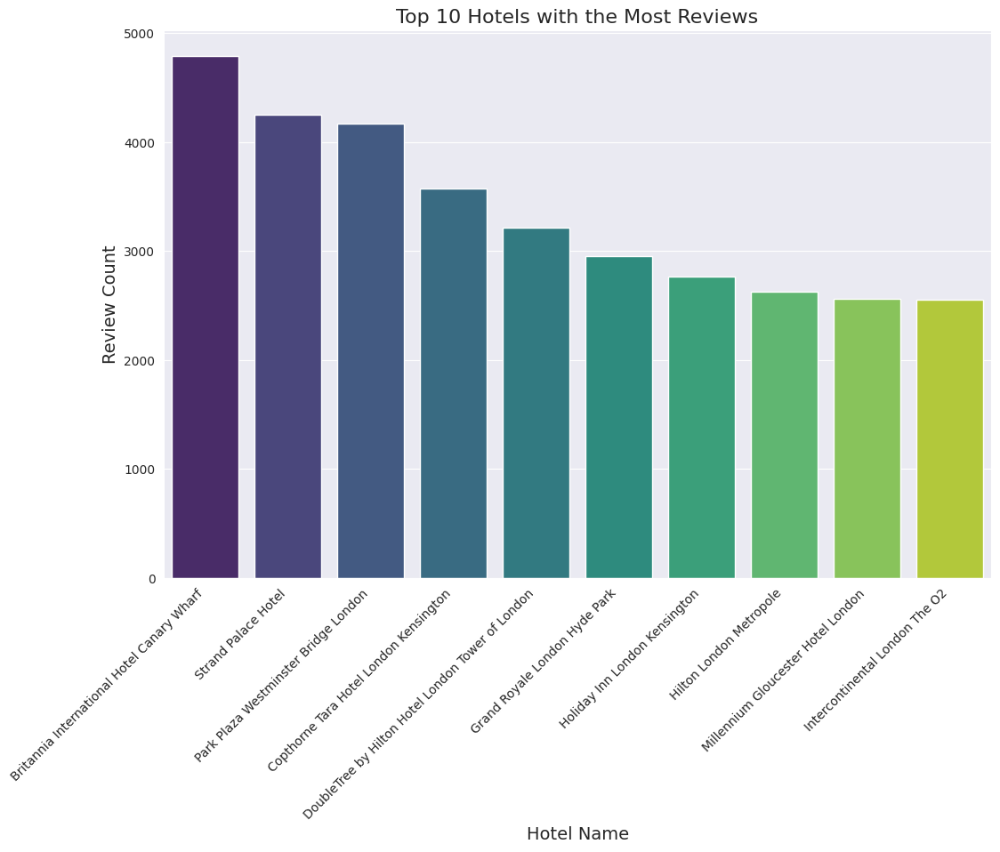

In [ ]:
names = df["Hotel_Name"].value_counts(dropna=False)[:10]

top_hotels_df = names.reset_index()
top_hotels_df.columns = ['Hotel_Name', 'Review_Count']

plt.figure(figsize=(12, 8))
ax = sns.barplot(data=top_hotels_df, x='Hotel_Name', y='Review_Count', palette='viridis')

ax.set_title("Top 10 Hotels with the Most Reviews", fontsize=16)
ax.set_xlabel("Hotel Name", fontsize=14)
ax.set_ylabel("Review Count", fontsize=14)

plt.xticks(rotation=45, ha='right')

plt.show()

In [ ]:
df['Positive_Review'] = df['Positive_Review'].replace('No Positive', '', regex=True)
df['Negative_Review'] = df['Negative_Review'].replace('No Negative', '', regex=True)

df['Total_Review'] = df['Negative_Review'] + df['Positive_Review']

df['review_type'] = df['Reviewer_Score'].apply(lambda x: 'Bad_review' if x < 7 else 'Good_review')

df_reviews = df[['Total_Review', 'review_type']]

df_reviews

,Total_Review,review_type
0,I am so angry that i made this post available...,Bad_review
1,No real complaints the hotel was great great ...,Good_review
2,Rooms are nice but for elderly a bit difficul...,Good_review
3,My room was dirty and I was afraid to walk ba...,Bad_review
4,You When I booked with your company on line y...,Bad_review
...,...,...
515733,no trolly or staff to help you take the lugga...,Good_review
515734,The hotel looks like 3 but surely not 4 Brea...,Bad_review
515735,The ac was useless It was a hot week in vienn...,Bad_review
515736,The rooms are enormous and really comfortable...,Good_review


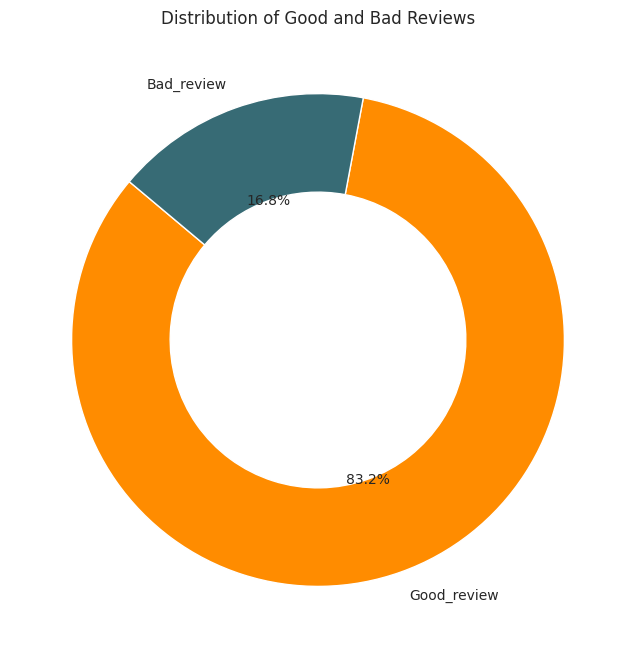

In [ ]:
review_counts = df_reviews['review_type'].value_counts()

plt.figure(figsize=(8, 8))
plt.pie(
    review_counts,
    labels=review_counts.index,
    autopct='%1.1f%%',
    colors=['darkorange', '#376B75'],
    startangle=140,
    wedgeprops=dict(width=0.4)
)

plt.title('Distribution of Good and Bad Reviews')

plt.show()

In [ ]:
good_reviews = df_reviews[df_reviews.review_type == "Good_review"]
bad_reviews = df_reviews[df_reviews.review_type == "Bad_review"]

In [ ]:
good_df = good_reviews.sample(n=len(bad_reviews), random_state=42)

In [ ]:
df_review_resampled = pd.concat([good_df, bad_reviews], ignore_index=True)

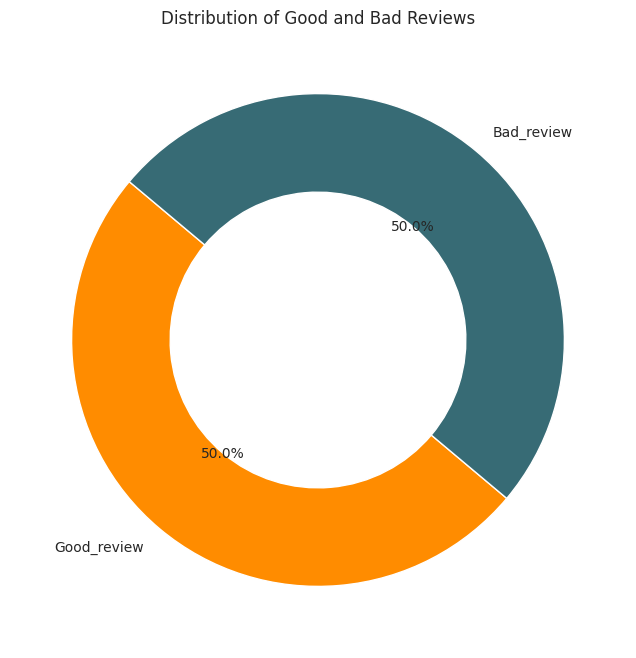

In [ ]:
review_counts = df_review_resampled['review_type'].value_counts()

plt.figure(figsize=(8, 8))
plt.pie(
    review_counts,
    labels=review_counts.index,
    autopct='%1.1f%%',
    colors=['darkorange', '#376B75'],
    startangle=140,
    wedgeprops=dict(width=0.4)
)

plt.title('Distribution of Good and Bad Reviews')

plt.show()

In [ ]:
encoder =LabelEncoder()
encoded_review = encoder.fit_transform(df_review_resampled.review_type.values)

In [ ]:
train_reviews, test_reviews, y_train, y_test = train_test_split(
    df_review_resampled.Total_Review,
    encoded_review,
    test_size=0.25,
    random_state=42
  )

In [ ]:
train_reviews.shape, test_reviews.shape, y_train.shape, y_test.shape

((129262,), (43088,), (129262,), (43088,))

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfv = TfidfVectorizer(
    min_df=3,
    strip_accents='unicode',
    analyzer='word',
    token_pattern=r'\w{1,}',
    ngram_range=(1, 3),
    use_idf=True,
    smooth_idf=True,
    sublinear_tf=True,
    stop_words='english'
)

all_reviews = list(train_reviews) + list(test_reviews)
tfv.fit(all_reviews)

X_train_tfv = tfv.transform(train_reviews)
X_test_tfv = tfv.transform(test_reviews)


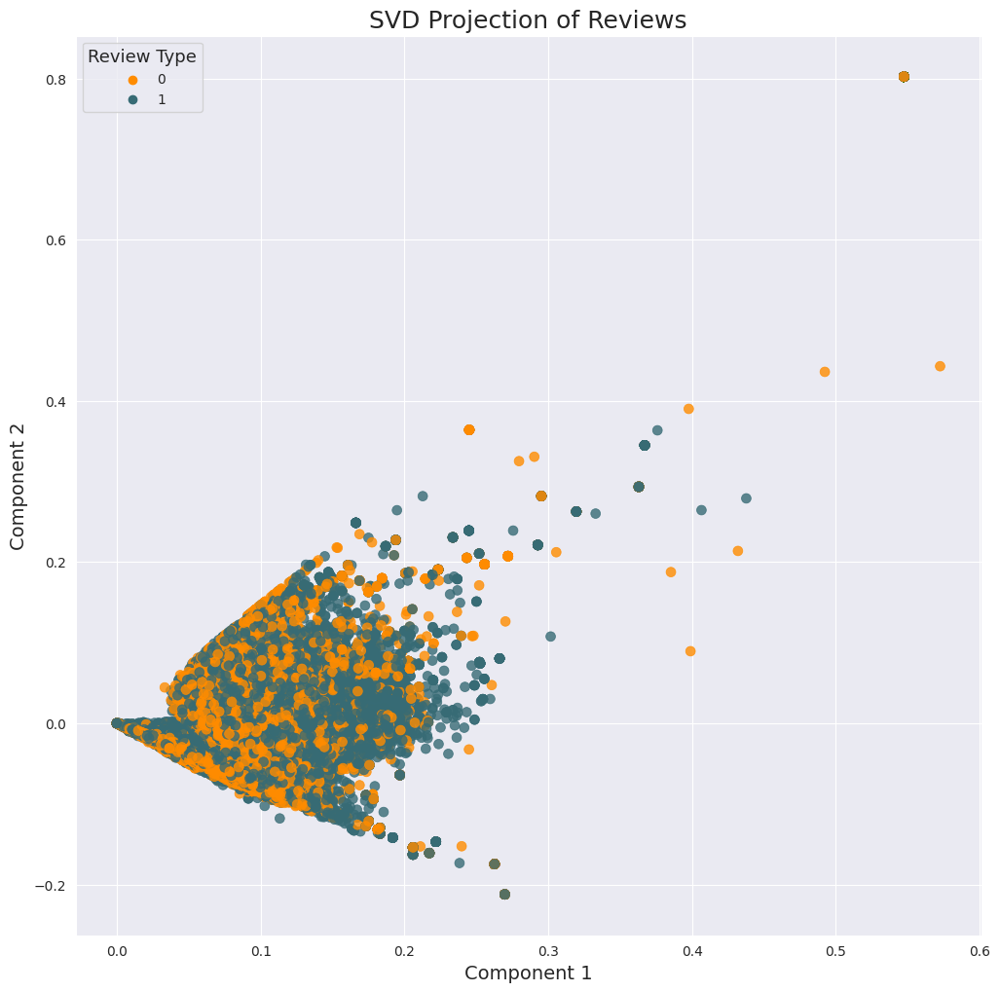

In [ ]:
def plot_svd(test_data, test_labels):
    svd = TruncatedSVD(n_components=2, random_state=42)
    svd_scores = svd.fit_transform(test_data)

    palette = sns.color_palette(['darkorange', '#376B75'])
    plt.figure(figsize=(12, 12))
    sns.scatterplot(x=svd_scores[:, 0], y=svd_scores[:, 1], hue=test_labels, palette=palette, s=50, alpha=0.8, edgecolor=None)

    plt.legend(title='Review Type', title_fontsize='13', loc='best')

    plt.title('SVD Projection of Reviews', fontsize=18)
    plt.xlabel('Component 1', fontsize=14)
    plt.ylabel('Component 2', fontsize=14)
    plt.grid(True)
    plt.show()

plot_svd(X_train_tfv, y_train)


In [ ]:
param_grid = {
    'max_depth': [5, 7],
    'n_estimators': [100, 200],
    'colsample_bytree': [0.6, 0.8],
    'learning_rate': [0.01, 0.1]
}

xgb_model = xgb.XGBClassifier(use_label_encoder=False, n_jobs=-1)

In [ ]:
grid_search = GridSearchCV(estimator=xgb_model, param_grid=param_grid, cv=3, scoring='accuracy', verbose=2, n_jobs=-1)

grid_search.fit(X_train_tfv, y_train)

print("Лучшие параметры:", grid_search.best_params_)

Fitting 3 folds for each of 16 candidates, totalling 48 fits


/opt/conda/lib/python3.10/site-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning:

os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.

/opt/conda/lib/python3.10/site-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning:

os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



[CV] END colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=100; total time= 2.6min
[CV] END colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=200; total time= 5.1min
[CV] END colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=100; total time= 6.9min
[CV] END colsample_bytree=0.6, learning_rate=0.1, max_depth=5, n_estimators=100; total time= 2.3min
[CV] END colsample_bytree=0.6, learning_rate=0.1, max_depth=5, n_estimators=100; total time= 2.3min
[CV] END colsample_bytree=0.6, learning_rate=0.1, max_depth=5, n_estimators=100; total time= 2.3min
[CV] END colsample_bytree=0.6, learning_rate=0.1, max_depth=5, n_estimators=200; total time= 4.2min
[CV] END colsample_bytree=0.6, learning_rate=0.1, max_depth=7, n_estimators=100; total time= 5.1min
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=5, n_estimators=100; total time= 3.2min


/opt/conda/lib/python3.10/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.



[CV] END colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=100; total time= 2.6min
[CV] END colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=200; total time= 5.1min
[CV] END colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=200; total time=13.3min
[CV] END colsample_bytree=0.6, learning_rate=0.1, max_depth=5, n_estimators=200; total time= 4.2min
[CV] END colsample_bytree=0.6, learning_rate=0.1, max_depth=7, n_estimators=100; total time= 5.1min
[CV] END colsample_bytree=0.6, learning_rate=0.1, max_depth=7, n_estimators=200; total time= 8.7min
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=5, n_estimators=200; total time= 6.3min
[CV] END colsample_bytree=0.8, learning_rate=0.01, max_depth=7, n_estimators=100; total time= 8.7min
[CV] END colsample_bytree=0.8, learning_rate=0.1, max_depth=5, n_estimators=100; total time= 2.8min
[CV] END colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=100; total time= 2

In [ ]:
best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

best_model.fit(X_train_tfv, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=7, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=200, n_jobs=-1,
              num_parallel_tree=None, random_state=None, ...)

In [ ]:
y_pred = best_model.predict(X_test_tfv)

print("Accuracy:", accuracy_score(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))

Accuracy: 0.7938637207575195
Classification Report:
               precision    recall  f1-score   support

           0       0.80      0.79      0.79     21569
           1       0.79      0.80      0.79     21519

    accuracy                           0.79     43088
   macro avg       0.79      0.79      0.79     43088
weighted avg       0.79      0.79      0.79     43088



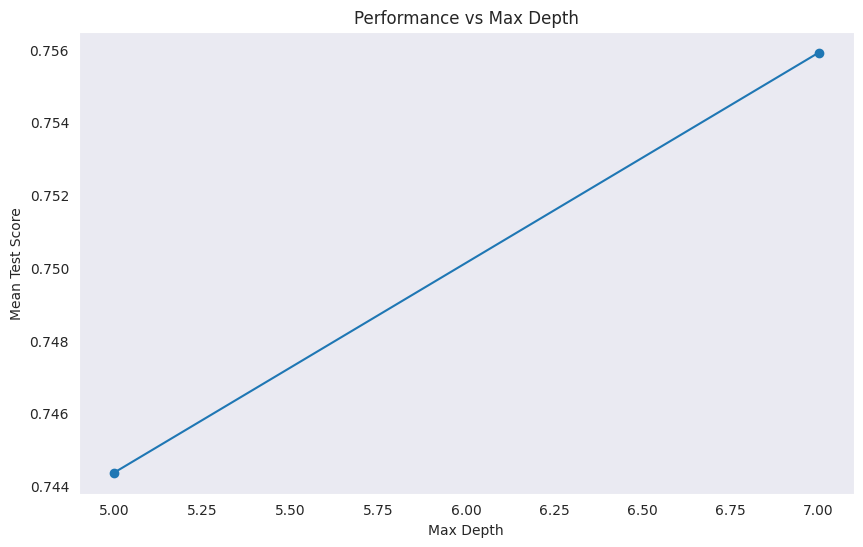

In [ ]:
unique_depths = sorted(set([p['max_depth'] for p in params]))

mean_scores = []
for depth in unique_depths:
    scores_for_depth = [mean_test_scores[i] for i in range(len(params)) if params[i]['max_depth'] == depth]
    mean_scores.append(np.mean(scores_for_depth))

plt.figure(figsize=(10, 6))
plt.plot(unique_depths, mean_scores, marker='o')
plt.xlabel('Max Depth')
plt.ylabel('Mean Test Score')
plt.title('Performance vs Max Depth')
plt.grid()
plt.show()


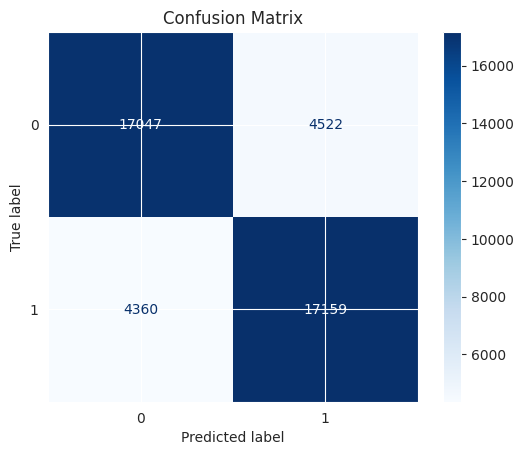

In [ ]:
cm = confusion_matrix(y_test, y_pred)

disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.show()

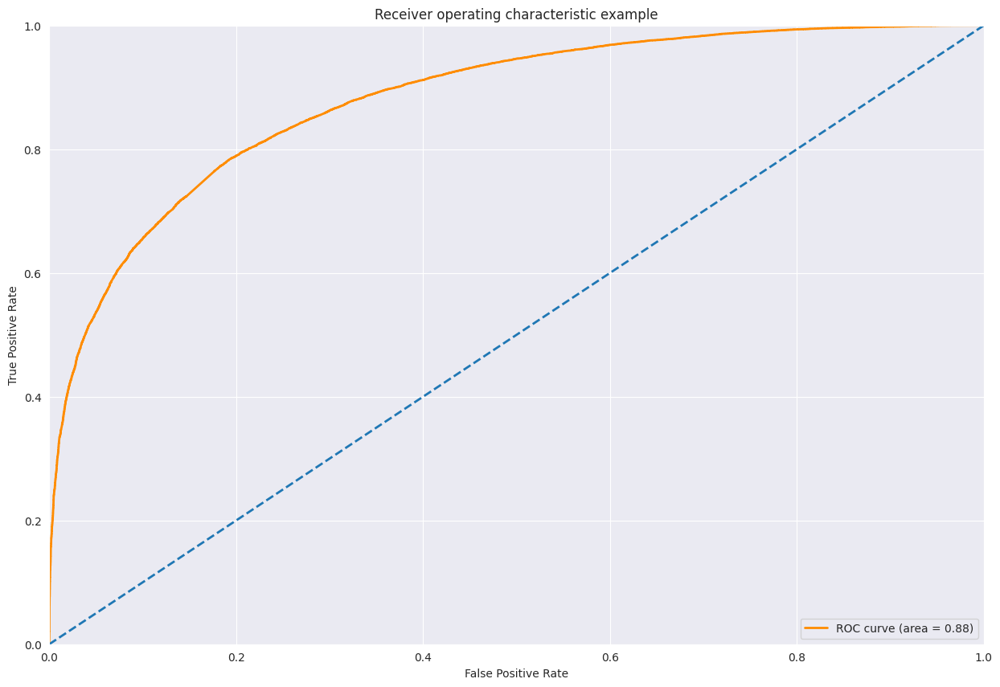

In [ ]:
y_pred = [x[1] for x in best_model.predict_proba(X_test_tfv)]
fpr, tpr, thresholds = roc_curve(y_test, y_pred, pos_label = 1)

roc_auc = auc(fpr, tpr)

plt.figure(1, figsize = (15, 10))
lw = 2
plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.show()

In [ ]:
loaded_model = xgb.XGBClassifier()
loaded_model.load_model("sentiment_model.json")

sample_text = "I love the room service"
vectorized_text = tfv.transform([sample_text])


sentiment = loaded_model.predict(vectorized_text)

print(f"The sentiment of this sentence is: {sentiment[0]}")

The sentiment of this sentence is: 1
